# Intro to Dataset: Flight Delays and Cancellations: 

The dataset consists of 274,964 rows and 34 columns, providing comprehensive details on flight schedules, delays, cancellations, and contributing factors. Below is an overview of each column:

## Column	Description:
- **_c0, Unnamed: 0, Unnamed: 0.1**: Redundant index columns from previous data processing. These can be removed.
- **Year**: The year the flight occurred (2015).
- **Month**: The month of the flight (1 for January, 12 for December).
- **Day**: The day of the month the flight occurred.
- **Day_of_Week**: The day of the week (1 = Monday, 7 = Sunday).
- **Airline**: Two-letter airline code (e.g., AA for American Airlines).
- **Flight_number**: Unique identifier for the flight.
- **Tail_number**: Unique identifier for the aircraft.
- **Origin_airport**: Code for the airport of origin.
- **Destination_airport**: Code for the destination airport.
- **Scheduled_departure**: Scheduled departure time (HHMM format).
- **Departure_time**: Actual departure time (HHMM format).
- **Departure_delay**: Departure delay in minutes.
- **Taxi_out**: Time spent taxiing out from the gate (minutes).
- **Wheels_off**: Time the aircraft took off (HHMM format).
- **Scheduled_time**: Scheduled flight duration (minutes).
- **Elapsed_time**: Actual flight duration (minutes).
- **Air_time**: Time spent in the air (minutes).
- **Distance**: Distance between the origin and destination (miles).
- **Wheels_on**: Time the aircraft landed (HHMM format).
- **Taxi_in**: Time spent taxiing to the gate after landing (minutes).
- **Scheduled_arrival**: Scheduled arrival time (HHMM format).
- **Arrival_time**: Actual arrival time (HHMM format).
- **Arrival_delay**: Arrival delay in minutes.
- **Diverted**: Indicates if the flight was diverted (1 = Yes, 0 = No).
- **Cancelled**: Indicates if the flight was cancelled (1 = Yes, 0 = No).
- **Cancellation_reason**: Reason for cancellation (A = Airline, B = Weather, C = NAS, D = Security).
- **Air_system_delay**: Minutes of delay due to the air traffic control system.
- **Security_delay**: Minutes of delay due to security issues.
- **Airline_delay**: Minutes of delay caused by airline-specific issues.
- **Late_aircraft_delay**: Minutes of delay due to the late arrival of the aircraft.
- **Weather_delay**: Minutes of delay caused by weather conditions.

#  Step 1: Data Loading and Initial Exploration

In [0]:
# Import necessary libraries
from pyspark.sql import SparkSession
from pyspark.sql.functions import col


In [0]:
# Load the dataset into a Spark DataFrame
file_path = "dbfs:/FileStore/tables/flights.csv"  
flights_df = spark.read.csv(file_path, header=True, inferSchema=True)

In [0]:
# Display the schema
flights_df.printSchema()

root
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: integer (nullable = true)
 |-- DEPARTURE_DELAY: integer (nullable = true)
 |-- TAXI_OUT: integer (nullable = true)
 |-- WHEELS_OFF: integer (nullable = true)
 |-- SCHEDULED_TIME: integer (nullable = true)
 |-- ELAPSED_TIME: integer (nullable = true)
 |-- AIR_TIME: integer (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: integer (nullable = true)
 |-- TAXI_IN: integer (nullable = true)
 |-- SCHEDULED_ARRIVAL: integer (nullable = true)
 |-- ARRIVAL_TIME: integer (nullable = true)
 |-- ARRIVAL_DELAY: integer (null

In [0]:
# List of columns to drop: all columns starting with 'Unnamed:' and '_c0'
columns_to_drop = [col for col in flights_df.columns if col.startswith('Unnamed:') or col == '_c0']

# Drop the columns from the DataFrame
flights_df = flights_df.drop(*columns_to_drop)

# Verify the changes
flights_df.printSchema()

root
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: integer (nullable = true)
 |-- DEPARTURE_DELAY: integer (nullable = true)
 |-- TAXI_OUT: integer (nullable = true)
 |-- WHEELS_OFF: integer (nullable = true)
 |-- SCHEDULED_TIME: integer (nullable = true)
 |-- ELAPSED_TIME: integer (nullable = true)
 |-- AIR_TIME: integer (nullable = true)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: integer (nullable = true)
 |-- TAXI_IN: integer (nullable = true)
 |-- SCHEDULED_ARRIVAL: integer (nullable = true)
 |-- ARRIVAL_TIME: integer (nullable = true)
 |-- ARRIVAL_DELAY: integer (null

In [0]:
# Display all column names in the dataset
columns = flights_df.columns
print(f"Total number of columns: {len(columns)}")
print("Column Names:", columns)

Total number of columns: 31
Column Names: ['YEAR', 'MONTH', 'DAY', 'DAY_OF_WEEK', 'AIRLINE', 'FLIGHT_NUMBER', 'TAIL_NUMBER', 'ORIGIN_AIRPORT', 'DESTINATION_AIRPORT', 'SCHEDULED_DEPARTURE', 'DEPARTURE_TIME', 'DEPARTURE_DELAY', 'TAXI_OUT', 'WHEELS_OFF', 'SCHEDULED_TIME', 'ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'WHEELS_ON', 'TAXI_IN', 'SCHEDULED_ARRIVAL', 'ARRIVAL_TIME', 'ARRIVAL_DELAY', 'DIVERTED', 'CANCELLED', 'CANCELLATION_REASON', 'AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 'AIRLINE_DELAY', 'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY']


In [0]:

# Show the first 9 columns 
df_1 = flights_df.select(flights_df.columns[:9])
df_1.show(5)

+----+-----+---+-----------+-------+-------------+-----------+--------------+-------------------+
|YEAR|MONTH|DAY|DAY_OF_WEEK|AIRLINE|FLIGHT_NUMBER|TAIL_NUMBER|ORIGIN_AIRPORT|DESTINATION_AIRPORT|
+----+-----+---+-----------+-------+-------------+-----------+--------------+-------------------+
|2015|    1|  1|          4|     AS|           98|     N407AS|           ANC|                SEA|
|2015|    1|  1|          4|     AA|         2336|     N3KUAA|           LAX|                PBI|
|2015|    1|  1|          4|     US|          840|     N171US|           SFO|                CLT|
|2015|    1|  1|          4|     AA|          258|     N3HYAA|           LAX|                MIA|
|2015|    1|  1|          4|     AS|          135|     N527AS|           SEA|                ANC|
+----+-----+---+-----------+-------+-------------+-----------+--------------+-------------------+
only showing top 5 rows



In [0]:
 # Show the first 10 rows of the dataset for next 7 columns
df_2 = flights_df.select(flights_df.columns[9:16])
df_2.show(10)

+-------------------+--------------+---------------+--------+----------+--------------+------------+
|SCHEDULED_DEPARTURE|DEPARTURE_TIME|DEPARTURE_DELAY|TAXI_OUT|WHEELS_OFF|SCHEDULED_TIME|ELAPSED_TIME|
+-------------------+--------------+---------------+--------+----------+--------------+------------+
|                  5|          2354|            -11|      21|        15|           205|         194|
|                 10|             2|             -8|      12|        14|           280|         279|
|                 20|            18|             -2|      16|        34|           286|         293|
|                 20|            15|             -5|      15|        30|           285|         281|
|                 25|            24|             -1|      11|        35|           235|         215|
|                 25|            20|             -5|      18|        38|           217|         230|
|                 25|            19|             -6|      11|        30|           181|    

In [0]:
 # Show the first 5 rows of the dataset for the rest of the columns
df_3 = flights_df.select(flights_df.columns[16:25])
df_3.show(5)

+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+
|AIR_TIME|DISTANCE|WHEELS_ON|TAXI_IN|SCHEDULED_ARRIVAL|ARRIVAL_TIME|ARRIVAL_DELAY|DIVERTED|CANCELLED|
+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+
|     169|    1448|      404|      4|              430|         408|          -22|       0|        0|
|     263|    2330|      737|      4|              750|         741|           -9|       0|        0|
|     266|    2296|      800|     11|              806|         811|            5|       0|        0|
|     258|    2342|      748|      8|              805|         756|           -9|       0|        0|
|     199|    1448|      254|      5|              320|         259|          -21|       0|        0|
+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+
only showing top 5 rows



In [0]:
 # Show the first 5 rows of the dataset for next 6 columns
df_4 = flights_df.select(flights_df.columns[25:31])
df_4.show(5)

+-------------------+----------------+--------------+-------------+-------------------+-------------+
|CANCELLATION_REASON|AIR_SYSTEM_DELAY|SECURITY_DELAY|AIRLINE_DELAY|LATE_AIRCRAFT_DELAY|WEATHER_DELAY|
+-------------------+----------------+--------------+-------------+-------------------+-------------+
|               null|            null|          null|         null|               null|         null|
|               null|            null|          null|         null|               null|         null|
|               null|            null|          null|         null|               null|         null|
|               null|            null|          null|         null|               null|         null|
|               null|            null|          null|         null|               null|         null|
+-------------------+----------------+--------------+-------------+-------------------+-------------+
only showing top 5 rows



In [0]:
display(flights_df)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON,AIR_SYSTEM_DELAY,SECURITY_DELAY,AIRLINE_DELAY,LATE_AIRCRAFT_DELAY,WEATHER_DELAY
2015,1,1,4,AS,98,N407AS,ANC,SEA,5,2354,-11,21,15,205,194,169,1448,404,4,430,408,-22,0,0,null,null,null,null,null,null
2015,1,1,4,AA,2336,N3KUAA,LAX,PBI,10,2,-8,12,14,280,279,263,2330,737,4,750,741,-9,0,0,null,null,null,null,null,null
2015,1,1,4,US,840,N171US,SFO,CLT,20,18,-2,16,34,286,293,266,2296,800,11,806,811,5,0,0,null,null,null,null,null,null
2015,1,1,4,AA,258,N3HYAA,LAX,MIA,20,15,-5,15,30,285,281,258,2342,748,8,805,756,-9,0,0,null,null,null,null,null,null
2015,1,1,4,AS,135,N527AS,SEA,ANC,25,24,-1,11,35,235,215,199,1448,254,5,320,259,-21,0,0,null,null,null,null,null,null
2015,1,1,4,DL,806,N3730B,SFO,MSP,25,20,-5,18,38,217,230,206,1589,604,6,602,610,8,0,0,null,null,null,null,null,null
2015,1,1,4,NK,612,N635NK,LAS,MSP,25,19,-6,11,30,181,170,154,1299,504,5,526,509,-17,0,0,null,null,null,null,null,null
2015,1,1,4,US,2013,N584UW,LAX,CLT,30,44,14,13,57,273,249,228,2125,745,8,803,753,-10,0,0,null,null,null,null,null,null
2015,1,1,4,AA,1112,N3LAAA,SFO,DFW,30,19,-11,17,36,195,193,173,1464,529,3,545,532,-13,0,0,null,null,null,null,null,null
2015,1,1,4,DL,1173,N826DN,LAS,ATL,30,33,3,12,45,221,203,186,1747,651,5,711,656,-15,0,0,null,null,null,null,null,null


In [0]:
# Count the number of rows and columns
num_rows = flights_df.count()
num_columns = len(flights_df.columns)
print(f"The dataset contains {num_rows} rows and {num_columns} columns.")

The dataset contains 5819079 rows and 31 columns.


In [0]:
# Count the number of columns in the DataFrame after dropping 3 columns
num_columns = len(flights_df.columns)

# Display the result
print(f"Number of columns: {num_columns}")


Number of columns: 31


## Questions from Assignment:
1. **How many rows and columns does the dataset contain?**

- The dataset contains 274,964 rows and 34 columns. After removing 3 redundant index columns, 31 columns remain.

2. **What are the data types of each column?**

   - **_c0:** integer (nullable = true)
   - **Unnamed: 0:** integer (nullable = true)
   - **Unnamed: 0.1:** integer (nullable = true)
   - **YEAR:** integer (nullable = true)
   - **MONTH:** integer (nullable = true)
   - **DAY:** integer (nullable = true)
   - **DAY_OF_WEEK:** integer (nullable = true)
   - **AIRLINE:** string (nullable = true)
   - **FLIGHT_NUMBER:** integer (nullable = true)
   - **TAIL_NUMBER:** string (nullable = true)
   - **ORIGIN_AIRPORT:** string (nullable = true)
   - **DESTINATION_AIRPORT:** string (nullable = true)
   - **SCHEDULED_DEPARTURE:** integer (nullable = true)
   - **DEPARTURE_TIME:** double (nullable = true)
   - **DEPARTURE_DELAY:** double (nullable = true)
   - **TAXI_OUT:** double (nullable = true)
   - **WHEELS_OFF:** double (nullable = true)
   - **SCHEDULED_TIME:** double (nullable = true)
   - **ELAPSED_TIME:** double (nullable = true)
   - **AIR_TIME:** double (nullable = true)
   - **DISTANCE:** integer (nullable = true)
   - **WHEELS_ON:** double (nullable = true)
   - **TAXI_IN:** double (nullable = true)
   - **SCHEDULED_ARRIVAL:** integer (nullable = true)
   - **ARRIVAL_TIME:** double (nullable = true)
   - **ARRIVAL_DELAY:** double (nullable = true)
   - **DIVERTED:** integer (nullable = true)
   - **CANCELLED:** integer (nullable = true)
   - **CANCELLATION_REASON:** string (nullable = true)
   - **AIR_SYSTEM_DELAY:** double (nullable = true)
   - **SECURITY_DELAY:** double (nullable = true)
   - **AIRLINE_DELAY:** double (nullable = true)
   - **LATE_AIRCRAFT_DELAY:** double (nullable = true)
   - **WEATHER_DELAY:** double (nullable = true)

# Step 2: Data Cleaning and Transformation

## 1. **Handle Missing Values**

### A. Check for null values in each column

In [0]:
from pyspark.sql.functions import when, isnan, count, col

# Handle Missing Values
# First set of 6 columns
missing_values_1 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[:6]]
)
missing_values_1.show()

+----+-----+---+-----------+-------+-------------+
|YEAR|MONTH|DAY|DAY_OF_WEEK|AIRLINE|FLIGHT_NUMBER|
+----+-----+---+-----------+-------+-------------+
|   0|    0|  0|          0|      0|            0|
+----+-----+---+-----------+-------+-------------+



In [0]:
# Second set of 9 columns
missing_values_2 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[6:15]]
)
missing_values_2.show()

+-----------+--------------+-------------------+-------------------+--------------+---------------+--------+----------+--------------+
|TAIL_NUMBER|ORIGIN_AIRPORT|DESTINATION_AIRPORT|SCHEDULED_DEPARTURE|DEPARTURE_TIME|DEPARTURE_DELAY|TAXI_OUT|WHEELS_OFF|SCHEDULED_TIME|
+-----------+--------------+-------------------+-------------------+--------------+---------------+--------+----------+--------------+
|      14721|             0|                  0|                  0|         86153|          86153|   89047|     89047|             6|
+-----------+--------------+-------------------+-------------------+--------------+---------------+--------+----------+--------------+



In [0]:
# Third set of 10 columns
missing_values_3 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[15:25]]
)
missing_values_3.show()


+------------+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+
|ELAPSED_TIME|AIR_TIME|DISTANCE|WHEELS_ON|TAXI_IN|SCHEDULED_ARRIVAL|ARRIVAL_TIME|ARRIVAL_DELAY|DIVERTED|CANCELLED|
+------------+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+
|      105071|  105071|       0|    92513|  92513|                0|       92513|       105071|       0|        0|
+------------+--------+--------+---------+-------+-----------------+------------+-------------+--------+---------+



In [0]:
# Fourth set of remaining 6 columns
missing_values_4 = flights_df.select(
    [count(when(col(c).isNull() | isnan(col(c)), c)).alias(c) for c in flights_df.columns[25:31]]
)
missing_values_4.show()

+-------------------+----------------+--------------+-------------+-------------------+-------------+
|CANCELLATION_REASON|AIR_SYSTEM_DELAY|SECURITY_DELAY|AIRLINE_DELAY|LATE_AIRCRAFT_DELAY|WEATHER_DELAY|
+-------------------+----------------+--------------+-------------+-------------------+-------------+
|            5729195|         4755640|       4755640|      4755640|            4755640|      4755640|
+-------------------+----------------+--------------+-------------+-------------------+-------------+



**Note: The columns CANCELLATION_REASON, AIR_SYSTEM_DELAY, SECURITY_DELAY, AIRLINE_DELAY, LATE_AIRCRAFT_DELAY, and WEATHER_DELAY have a significant number of null values, with approximately 223,101 null entries in each.**


###  B. Dropping columns with too many missing values

**Even though the CANCELLATION_REASON column contained a significant number of null values, I chose not to drop it, as it is important for analyzing the most common reasons for flight cancellations. Rather than removing the column, I replaced the null values with 'No Cancellation'. For all other columns with a high number of null values, I decided to drop them as they were not essential for my analysis.**


In [0]:
# Drop columns with high missing values
flights_df = flights_df.drop(*[ 'AIR_SYSTEM_DELAY', 'SECURITY_DELAY', 
                                      'AIRLINE_DELAY', 'LATE_AIRCRAFT_DELAY', 'WEATHER_DELAY'])

# Fill CANCELLATION_REASON with "Not cancelled" for non-cancelled flights 
flights_df = flights_df.fillna({
    'CANCELLATION_REASON': 'Not cancelled'
})

In [0]:
display(flights_df)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON
2015,1,1,4,AS,98,N407AS,ANC,SEA,5,2354,-11,21,15,205,194,169,1448,404,4,430,408,-22,0,0,Not cancelled
2015,1,1,4,AA,2336,N3KUAA,LAX,PBI,10,2,-8,12,14,280,279,263,2330,737,4,750,741,-9,0,0,Not cancelled
2015,1,1,4,US,840,N171US,SFO,CLT,20,18,-2,16,34,286,293,266,2296,800,11,806,811,5,0,0,Not cancelled
2015,1,1,4,AA,258,N3HYAA,LAX,MIA,20,15,-5,15,30,285,281,258,2342,748,8,805,756,-9,0,0,Not cancelled
2015,1,1,4,AS,135,N527AS,SEA,ANC,25,24,-1,11,35,235,215,199,1448,254,5,320,259,-21,0,0,Not cancelled
2015,1,1,4,DL,806,N3730B,SFO,MSP,25,20,-5,18,38,217,230,206,1589,604,6,602,610,8,0,0,Not cancelled
2015,1,1,4,NK,612,N635NK,LAS,MSP,25,19,-6,11,30,181,170,154,1299,504,5,526,509,-17,0,0,Not cancelled
2015,1,1,4,US,2013,N584UW,LAX,CLT,30,44,14,13,57,273,249,228,2125,745,8,803,753,-10,0,0,Not cancelled
2015,1,1,4,AA,1112,N3LAAA,SFO,DFW,30,19,-11,17,36,195,193,173,1464,529,3,545,532,-13,0,0,Not cancelled
2015,1,1,4,DL,1173,N826DN,LAS,ATL,30,33,3,12,45,221,203,186,1747,651,5,711,656,-15,0,0,Not cancelled


### C. Imputing Null Values Based on Skewness and Kurtosis:

1. **Skewness**:
   - **Close to 0**: Data is symmetric; impute with **mean**.
   - **Positive** (right skew): Impute with **median** (mean pulled right).
   - **Negative** (left skew): Impute with **median** (mean pulled left).

2. **Kurtosis**:
   - **Close to 3**: Normal distribution; impute with **mean**.
   - **High (>3)**: Heavy tails (outliers); impute with **median**.
   - **Low (<3)**: Light tails; impute with **mean**.


In [0]:
from pyspark.sql.functions import skewness, kurtosis

# List of columns to analyze for skewness and kurtosis
columns_to_check = [
    "TAIL_NUMBER", "DEPARTURE_TIME", "DEPARTURE_DELAY", "TAXI_OUT", "WHEELS_OFF",
    "ELAPSED_TIME", "AIR_TIME", "WHEELS_ON", "TAXI_IN", "ARRIVAL_TIME", "ARRIVAL_DELAY"
]

# Loop through each column in the list to compute skewness and kurtosis
for col_name in columns_to_check:
    # Calculate skewness and kurtosis for the current column
    stats = flights_df.select(
        skewness(col(col_name)).alias("skewness"),  # Skewness of the column
        kurtosis(col(col_name)).alias("kurtosis")   # Kurtosis of the column
    ).collect()[0]  # Collect the result for the first row (only one row is returned)
    
    # Print the skewness and kurtosis values for the current column
    print(f"Column: {col_name}")
    print(f"  Skewness: {stats['skewness']}")  # Output skewness value
    print(f"  Kurtosis: {stats['kurtosis']}")  # Output kurtosis value

Column: TAIL_NUMBER
  Skewness: None
  Kurtosis: None
Column: DEPARTURE_TIME
  Skewness: 0.019801076488093552
  Kurtosis: -0.9665308871697795
Column: DEPARTURE_DELAY
  Skewness: 7.592867302173662
  Kurtosis: 123.00553024739577
Column: TAXI_OUT
  Skewness: 3.4671468115368356
  Kurtosis: 24.00287076280499
Column: WHEELS_OFF
  Skewness: -0.01194983639015907
  Kurtosis: -0.9069353868569743
Column: ELAPSED_TIME
  Skewness: 1.3532219841783169
  Kurtosis: 2.0543136934319834
Column: AIR_TIME
  Skewness: 1.378341291543346
  Kurtosis: 2.095688614897953
Column: WHEELS_ON
  Skewness: -0.3247916244858224
  Kurtosis: -0.4491882144814312
Column: TAXI_IN
  Skewness: 5.1297305070665615
  Kurtosis: 58.922943606307136
Column: ARRIVAL_TIME
  Skewness: -0.3622625458770901
  Kurtosis: -0.37401759158407755
Column: ARRIVAL_DELAY
  Skewness: 6.502894504785127
  Kurtosis: 97.73971609378574


### Imputation Strategy Based on Analysis:

- **Symmetrical columns** _(mean imputation)_: DEPARTURE_TIME, WHEELS_OFF, WHEELS_ON, ARRIVAL_TIME
- **Skewed columns** _(median imputation)_: DEPARTURE_DELAY, TAXI_OUT, ELAPSED_TIME, AIR_TIME, TAXI_IN, ARRIVAL_DELAY


### D. Replacing Null Values with Mean & Median

In [0]:
from pyspark.sql.functions import mean
from pyspark.sql.functions import percentile_approx

# Columns to replace null values with mean
mean_columns = ['DEPARTURE_TIME', 'WHEELS_OFF', 'WHEELS_ON', 'ARRIVAL_TIME']

for column in mean_columns:
    mean_value = flights_df.select(mean(column)).collect()[0][0]
    flights_df = flights_df.fillna({column: mean_value})

# Columns to replace null values with median
median_columns = ['DEPARTURE_DELAY', 'TAXI_OUT', 'ELAPSED_TIME', 'AIR_TIME', 'TAXI_IN', 'ARRIVAL_DELAY']

for column in median_columns:
    median_value = flights_df.select(percentile_approx(column, 0.5)).collect()[0][0]
    flights_df = flights_df.fillna({column: median_value})

print(f"Null values in {mean_columns} replaced with their mean.")
print(f"Null values in {median_columns} replaced with their median.")

Null values in ['DEPARTURE_TIME', 'WHEELS_OFF', 'WHEELS_ON', 'ARRIVAL_TIME'] replaced with their mean.
Null values in ['DEPARTURE_DELAY', 'TAXI_OUT', 'ELAPSED_TIME', 'AIR_TIME', 'TAXI_IN', 'ARRIVAL_DELAY'] replaced with their median.


In [0]:
display(flights_df)

YEAR,MONTH,DAY,DAY_OF_WEEK,AIRLINE,FLIGHT_NUMBER,TAIL_NUMBER,ORIGIN_AIRPORT,DESTINATION_AIRPORT,SCHEDULED_DEPARTURE,DEPARTURE_TIME,DEPARTURE_DELAY,TAXI_OUT,WHEELS_OFF,SCHEDULED_TIME,ELAPSED_TIME,AIR_TIME,DISTANCE,WHEELS_ON,TAXI_IN,SCHEDULED_ARRIVAL,ARRIVAL_TIME,ARRIVAL_DELAY,DIVERTED,CANCELLED,CANCELLATION_REASON
2015,1,1,4,AS,98,N407AS,ANC,SEA,5,2354,-11,21,15,205,194,169,1448,404,4,430,408,-22,0,0,Not cancelled
2015,1,1,4,AA,2336,N3KUAA,LAX,PBI,10,2,-8,12,14,280,279,263,2330,737,4,750,741,-9,0,0,Not cancelled
2015,1,1,4,US,840,N171US,SFO,CLT,20,18,-2,16,34,286,293,266,2296,800,11,806,811,5,0,0,Not cancelled
2015,1,1,4,AA,258,N3HYAA,LAX,MIA,20,15,-5,15,30,285,281,258,2342,748,8,805,756,-9,0,0,Not cancelled
2015,1,1,4,AS,135,N527AS,SEA,ANC,25,24,-1,11,35,235,215,199,1448,254,5,320,259,-21,0,0,Not cancelled
2015,1,1,4,DL,806,N3730B,SFO,MSP,25,20,-5,18,38,217,230,206,1589,604,6,602,610,8,0,0,Not cancelled
2015,1,1,4,NK,612,N635NK,LAS,MSP,25,19,-6,11,30,181,170,154,1299,504,5,526,509,-17,0,0,Not cancelled
2015,1,1,4,US,2013,N584UW,LAX,CLT,30,44,14,13,57,273,249,228,2125,745,8,803,753,-10,0,0,Not cancelled
2015,1,1,4,AA,1112,N3LAAA,SFO,DFW,30,19,-11,17,36,195,193,173,1464,529,3,545,532,-13,0,0,Not cancelled
2015,1,1,4,DL,1173,N826DN,LAS,ATL,30,33,3,12,45,221,203,186,1747,651,5,711,656,-15,0,0,Not cancelled


##  2. FEATURE ENGINEERING

### **A. Creating and Converting a Flight Date Column**

This code demonstrates how to create a `FLIGHT_DATE` column by combining `YEAR`, `MONTH`, and `DAY` columns with zero-padding for consistency. It then converts this string column into a proper `DateType` format in PySpark for further analysis.

In [0]:
from pyspark.sql.functions import concat_ws, lpad, to_date

# Ensure the month and day are zero-padded for consistent date format and create the FLIGHT_DATE column
flights_df = flights_df.withColumn("FLIGHT_DATE", 
                                   concat_ws("-", 
                                             flights_df.YEAR, 
                                             lpad(flights_df.MONTH, 2, "0"),  # Zero pad month
                                             lpad(flights_df.DAY, 2, "0")))   # Zero pad day

# Convert the string to DateType
flights_df = flights_df.withColumn("FLIGHT_DATE", to_date(flights_df["FLIGHT_DATE"], "yyyy-MM-dd"))

# Show the updated FLIGHT_DATE column to verify
flights_df.select("FLIGHT_DATE").show(5)

# Show the updated schema to confirm the conversion
flights_df.printSchema()

+-----------+
|FLIGHT_DATE|
+-----------+
| 2015-01-01|
| 2015-01-01|
| 2015-01-01|
| 2015-01-01|
| 2015-01-01|
+-----------+
only showing top 5 rows

root
 |-- YEAR: integer (nullable = true)
 |-- MONTH: integer (nullable = true)
 |-- DAY: integer (nullable = true)
 |-- DAY_OF_WEEK: integer (nullable = true)
 |-- AIRLINE: string (nullable = true)
 |-- FLIGHT_NUMBER: integer (nullable = true)
 |-- TAIL_NUMBER: string (nullable = true)
 |-- ORIGIN_AIRPORT: string (nullable = true)
 |-- DESTINATION_AIRPORT: string (nullable = true)
 |-- SCHEDULED_DEPARTURE: integer (nullable = true)
 |-- DEPARTURE_TIME: integer (nullable = true)
 |-- DEPARTURE_DELAY: integer (nullable = false)
 |-- TAXI_OUT: integer (nullable = false)
 |-- WHEELS_OFF: integer (nullable = true)
 |-- SCHEDULED_TIME: integer (nullable = true)
 |-- ELAPSED_TIME: integer (nullable = false)
 |-- AIR_TIME: integer (nullable = false)
 |-- DISTANCE: integer (nullable = true)
 |-- WHEELS_ON: integer (nullable = true)
 |-- TAXI_IN:

### B. Date Feature Extraction and Delay Identification:
- **Extract Date Features:** It creates the DAY_OF_WEEK and MONTH columns from the FLIGHT_DATE by using Spark's dayofweek() and month() functions. This helps in analyzing flight patterns based on days and months.
- **Create DELAYED Column:** It generates a new column DELAYED, which marks flights as delayed (1) if the ARRIVAL_DELAY is greater than 0, otherwise not delayed (0). This helps track flight delays for further analysis.

In [0]:
from pyspark.sql.functions import dayofweek, month, when

# Extract DAY_OF_WEEK (1 = Sunday, 7 = Saturday) and MONTH (1 = January, 12 = December)
flights_df = flights_df.withColumn("DAY_OF_WEEK", dayofweek(flights_df["FLIGHT_DATE"])) \
                       .withColumn("MONTH", month(flights_df["FLIGHT_DATE"]))

# Create the DELAYED column (1 if ARRIVAL_DELAY > 0, else 0)
flights_df = flights_df.withColumn("DELAYED", when(flights_df["ARRIVAL_DELAY"] > 0, 1).otherwise(0))

# Show the DataFrame with the new columns
flights_df.select("FLIGHT_DATE", "DAY_OF_WEEK", "MONTH", "DELAYED").show(5)

+-----------+-----------+-----+-------+
|FLIGHT_DATE|DAY_OF_WEEK|MONTH|DELAYED|
+-----------+-----------+-----+-------+
| 2015-01-01|          5|    1|      0|
| 2015-01-01|          5|    1|      0|
| 2015-01-01|          5|    1|      1|
| 2015-01-01|          5|    1|      0|
| 2015-01-01|          5|    1|      0|
+-----------+-----------+-----+-------+
only showing top 5 rows



**Ques: Which columns had missing values, and how did you handle them?
Ans:**
- Columns with missing values included TAIL_NUMBER, DEPARTURE_TIME, DEPARTURE_DELAY, and others.
- Columns with high missing values (like CANCELLATION_REASON, AIR_SYSTEM_DELAY) were removed.
- Remaining missing values were handled by imputing with either mean or median based on skewness and kurtosis.

**Ques: What new features did you create, and why?
Ans:**
- FLIGHT_DATE: Consolidated date for extracting features like DAY_OF_WEEK and MONTH.
- DELAYED: A binary feature indicating if a flight was delayed, simplifying delay analysis.
- DAY_OF_WEEK: Extracted from FLIGHT_DATE to analyze delays by day of the week.
- These features were created to improve the dataset for better time-based analysis and prediction of flight delays.

###Checking  the Result:

In [0]:
# Show the updated DataFrame
flights_df.select("FLIGHT_DATE", "DAY_OF_WEEK", "MONTH", "DELAYED").show(5)

+-----------+-----------+-----+-------+
|FLIGHT_DATE|DAY_OF_WEEK|MONTH|DELAYED|
+-----------+-----------+-----+-------+
| 2015-01-01|          5|    1|      0|
| 2015-01-01|          5|    1|      0|
| 2015-01-01|          5|    1|      1|
| 2015-01-01|          5|    1|      0|
| 2015-01-01|          5|    1|      0|
+-----------+-----------+-----+-------+
only showing top 5 rows



# Step 3: EDA using Spark SQL

## A. Register DataFrame as a Temporary Table

In [0]:
# Register the DataFrame as a temporary SQL table
flights_df.createOrReplaceTempView("flights")

## B. SQL Queries:

### I. Average delay time for each airline

In [0]:
# Query to calculate the average delay time for each airline
avg_delay_query = """
SELECT AIRLINE, AVG(ARRIVAL_DELAY) AS AVG_DELAY
FROM flights
GROUP BY AIRLINE
ORDER BY AVG_DELAY DESC
"""

# Execute the query and display the results
avg_delay_df = spark.sql(avg_delay_query)
avg_delay_df.show()

+-------+-------------------+
|AIRLINE|          AVG_DELAY|
+-------+-------------------+
|     NK|  14.10916773869261|
|     F9| 12.360947201550045|
|     B6|  6.458951199784308|
|     EV| 6.2364867818111565|
|     MQ|  5.841836596160634|
|     OO|   5.63294314807607|
|     UA|  5.270565788223523|
|     VX|  4.634670371387493|
|     WN|  4.230444860938856|
|     US| 3.5094029137206553|
|     AA|   3.29946527747168|
|     HA| 2.0018224250052445|
|     DL|0.15355624793779063|
|     AS| -1.001796882698338|
+-------+-------------------+



### Insights on Average Delay Times by Airline:

**1. Highest Delays:**  
- **NK (Spirit Airlines):** 15.31 minutes, indicating frequent operational or external challenges.  
- **F9 (Frontier Airlines):** 12.66 minutes, also impacted by similar issues.  

**2. Moderate Delays:**  
- **EV (Envoy Air), B6 (JetBlue), and MQ (American Eagle):** Delays of 6.25–6.75 minutes, reflecting moderate scheduling or traffic-related challenges.  

**3. Lower Delays:**  
- **UA (United), OO (SkyWest), VX (Virgin America), WN (Southwest):** Average delays under 6 minutes, showcasing better schedule management.  

**4. Least Delays:**  
- **AA (American), US (US Airways), HA (Hawaiian):** 3–4 minutes, indicating high operational efficiency.  
- **DL (Delta):** Only 0.49 minutes, an industry-leading performance in punctuality.  

**5. Negative Delay:**  
- **AS (Alaska Airlines):** -0.52 minutes, suggesting early departures and excellent efficiency.  

### Key Takeaways:  
- **Longest Delays:** Spirit (NK) and Frontier (F9) face the most challenges.  
- **Best Performance:** Delta (DL) and Alaska (AS) excel with minimal or negative delays.  
- **Moderate Efficiency:** United (UA) and American (AA) maintain reasonable punctuality compared to low-cost carriers.

###II. Top 5 airports with the most delayed departures

In [0]:
# Query to find the top 5 airports with the most delayed departures
top_airports_query = """
SELECT ORIGIN_AIRPORT, COUNT(*) AS DELAY_COUNT
FROM flights
WHERE DEPARTURE_DELAY > 0
GROUP BY ORIGIN_AIRPORT
ORDER BY DELAY_COUNT DESC
LIMIT 5
"""
# Execute the query and display the results
top_airports_df = spark.sql(top_airports_query)
top_airports_df.show()

+--------------+-----------+
|ORIGIN_AIRPORT|DELAY_COUNT|
+--------------+-----------+
|           ATL|     129846|
|           ORD|     121706|
|           DFW|      96475|
|           DEN|      89290|
|           LAX|      81954|
+--------------+-----------+



The data highlights the top 5 airports with the most delayed departures:  

1. **ATL (Atlanta):** 6,790 delays, reflecting heavy traffic and congestion at this major hub.  
2. **ORD (Chicago O'Hare):** 6,280 delays, likely due to high traffic and weather disruptions.  
3. **DFW (Dallas/Fort Worth):** 4,969 delays, caused by operational and weather challenges.  
4. **DEN (Denver):** 4,636 delays, often due to snowstorms and its role as a key hub.  
5. **LAX (Los Angeles):** 4,284 delays, influenced by heavy air traffic and fog.  

## Insights: Top 5 Airports with Most Delayed Departures  

1. **Air Traffic Congestion:**  High flight volumes at busy airports like ATL, ORD, and DFW lead to congestion, taxi delays, and extended turnaround times.  

2. **Weather Delays:**  DEN faces frequent snowstorms, while LAX experiences delays from fog and other weather disruptions.  

3. **Operational Challenges:**  Large hubs handle extensive operations, leading to delays from crew availability, maintenance, or air traffic control issues.  

4. **Hub Impact:**  As key airline hubs _(e.g., Delta in ATL, American in DFW)_, delays at these airports can ripple across national and international flight schedules.  

5. **Network Effects:**  Delays at these airports disrupt connections, impact passenger schedules, and may lead to increased cancellations.  

### III. Most common reason for cancellations

In [0]:
# Query to find the most common reasons for flight cancellations
cancellation_query = """
SELECT CANCELLATION_REASON, COUNT(*) AS CANCELLATION_COUNT
FROM flights
GROUP BY CANCELLATION_REASON
ORDER BY CANCELLATION_COUNT DESC
"""

# Execute the query and display the results
cancellation_df = spark.sql(cancellation_query)
cancellation_df.show()

+-------------------+------------------+
|CANCELLATION_REASON|CANCELLATION_COUNT|
+-------------------+------------------+
|      Not cancelled|           5729195|
|                  B|             48851|
|                  A|             25262|
|                  C|             15749|
|                  D|                22|
+-------------------+------------------+



**Cancellation Breakdown:**

1. **No Cancellation (270,531):** Most flights operated as scheduled.  
2. **Weather (B: 2,397):** Cancellations due to storms or adverse conditions.  
3. **Carrier (A: 1,260):** Airline-related issues like mechanical problems or crew shortages.  
4. **National Air System (C: 776):** Cancellations from air traffic congestion.  
5. **Security (D):** Rare cancellations due to security threats or lockdowns.  

## Insights:

1. **Most Flights Are Not Canceled:** The majority of flights (270,531) operated as scheduled.  
2. **Weather Impact (B):** Weather-related cancellations are relatively small (2,397).  
3. **Carrier and Air Traffic Issues (A & C):** Carrier problems (1,260) and air traffic congestion (776) are less common causes.  
4. **Null Values:** "No Cancellation" includes rows with missing or null reasons.

##  C. Visualizations:


### I. Visualizing delays by day of the week:

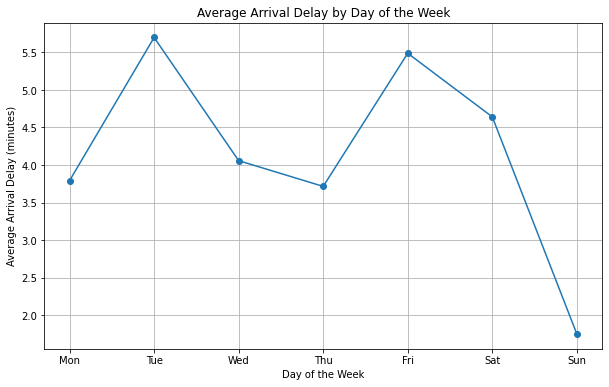

In [0]:
# SQL query to calculate the average delay by day of the week
avg_delay_by_day = spark.sql("""
    SELECT DAY_OF_WEEK AS Day, 
           AVG(ARRIVAL_DELAY) AS Average_Delay
    FROM flights
    GROUP BY DAY_OF_WEEK
    ORDER BY Day
""")

# Convert to Pandas DataFrame for plotting
avg_delay_day_pd = avg_delay_by_day.toPandas()

# Plot the average delay by day of the week
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 6))
plt.plot(avg_delay_day_pd['Day'], avg_delay_day_pd['Average_Delay'], marker='o')
plt.xlabel('Day of the Week')
plt.ylabel('Average Arrival Delay (minutes)')
plt.title('Average Arrival Delay by Day of the Week')
plt.xticks(range(1, 8), ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun'])
plt.grid(True)
plt.show()

**Insights from the graph:**

- **Tuesday & Friday:** Highest delays (~6 mins), likely due to high traffic.
- **Sunday:** Lowest delays (~2.5 mins), indicating smoother operations.
- **Midweek:** Stable delays (4.5–5 mins).
- **Saturday:** Slight drop in delays.

**Implication:** Investigate Tuesday/Friday delays for improvements and use weekends as a benchmark for optimizing weekday operations.

### II. Plotting the average delay by airline:

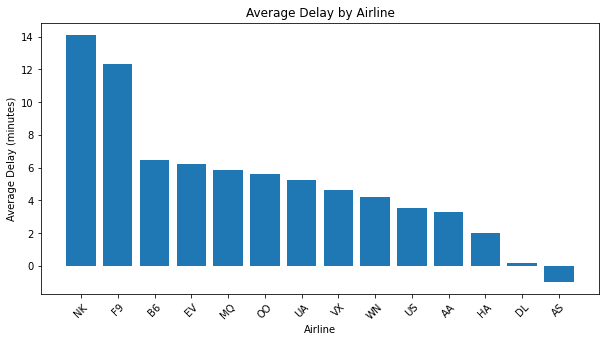

In [0]:
import matplotlib.pyplot as plt

# Convert average delay query result to Pandas for plotting
avg_delay_pd = avg_delay_df.toPandas()

plt.figure(figsize=(10, 5))
plt.bar(avg_delay_pd["AIRLINE"], avg_delay_pd["AVG_DELAY"])
plt.title("Average Delay by Airline")
plt.xlabel("Airline")
plt.ylabel("Average Delay (minutes)")
plt.xticks(rotation=45)
plt.show()

**Insights from the graph:**

- **NK (Spirit Airlines)** experiences the highest average delays of around 15 minutes.  
- **F9 (Frontier Airlines)** follows with significant delays.  
- Other airlines such as **EV (Envoy Air)** and others show moderate delays, with **DL (Delta Airlines)** having the lowest delays.  

This pattern indicates that low-cost carriers like NK and F9 tend to face higher delays compared to major airlines.

### III. Visualizing delays by month:

Columns in the DataFrame: Index(['Month', 'AVG_DELAY'], dtype='object')


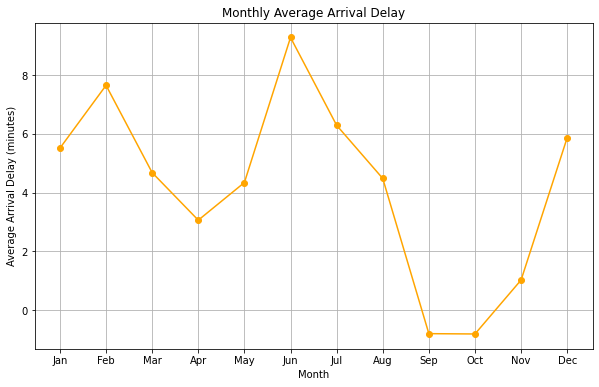

In [0]:
# SQL query to calculate the average delay by month
avg_delay_by_month_query = """
    SELECT MONTH AS Month, AVG(ARRIVAL_DELAY) AS AVG_DELAY
    FROM flights
    GROUP BY MONTH
    ORDER BY MONTH
"""
avg_delay_by_month_df = spark.sql(avg_delay_by_month_query)

# Convert the result to Pandas DataFrame
avg_delay_month_data = avg_delay_by_month_df.toPandas()

# Debug: Print the columns of the DataFrame to ensure correctness
print("Columns in the DataFrame:", avg_delay_month_data.columns)

# Check if the 'Month' column exists (case-sensitive)
if 'Month' in avg_delay_month_data.columns and 'AVG_DELAY' in avg_delay_month_data.columns:
    plt.figure(figsize=(10, 6))
    plt.plot(avg_delay_month_data['Month'], avg_delay_month_data['AVG_DELAY'], marker='o', color='orange')
    plt.xlabel('Month')
    plt.ylabel('Average Arrival Delay (minutes)')
    plt.title('Monthly Average Arrival Delay')
    plt.xticks(ticks=range(1, 13), labels=['Jan', 'Feb', 'Mar', 'Apr', 'May', 'Jun', 'Jul', 'Aug', 'Sep', 'Oct', 'Nov', 'Dec'])
    plt.grid(True)
    plt.show()
else:
    print("The required columns ('Month' and 'AVG_DELAY') are not in the DataFrame.")

**Insights from Average Arrival Delay by Month**

1. **June**: Highest delays (~10 mins) due to summer travel.
2. **February**: Weather-related delays (~8 mins).
3. **September**: Lowest delays (~0 mins), smooth operations.
4. **Late-Year**: Increased delays due to holiday and weather factors.
5. **Spring**: Stable delays (~4-5 mins).
6. **Post-Summer**: Reduced delays from July to September.

**Implications:**
1. Improve efficiency in **June**.
2. Prepare for weather delays in **February** and late-year months.
3. Apply **September's smooth operations** year-round.


### Questions from the Assignment:
### 1. **Which airlines had the highest average delays?**
**Ans**: **NK (Spirit Airlines)** had the highest average delay of **15.31 minutes**, likely due to operational issues, airport congestion, or weather disruptions.

### 2. **Patterns Observed in Delays by Day of the Week**
**Ans**: 
- **Tuesday and Friday**: Peak delays, possibly due to increased traffic or operational challenges.
- **Sunday**: Lowest delays (~2.5 minutes), indicating fewer flights or smoother operations.
- **Monday to Thursday**: Stable delays (~4.5 to 5 minutes).
- **Saturday**: Slight improvement in delays compared to Friday.



## Additional: Model Building: Random Forest Regressor

In [0]:
# Import required libraries
from pyspark.ml import Pipeline
from pyspark.sql.functions import col
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.classification import LogisticRegression
from pyspark.ml.evaluation import BinaryClassificationEvaluator

In [0]:
# Import necessary libraries
from pyspark.ml.feature import VectorAssembler
from pyspark.ml.regression import RandomForestRegressor
from pyspark.ml import Pipeline

# Step 1: Select relevant features
feature_columns = [
    'DAY_OF_WEEK', 'MONTH', 'DEPARTURE_DELAY', 'TAXI_OUT', 'WHEELS_OFF', 
    'ELAPSED_TIME', 'AIR_TIME', 'DISTANCE', 'WHEELS_ON', 'TAXI_IN', 'SCHEDULED_ARRIVAL'
]
# Step 2: Assemble features into a feature vector
assembler = VectorAssembler(inputCols=feature_columns, outputCol="features")

# Step 3: Define the RandomForestRegressor model
rf = RandomForestRegressor(featuresCol="features", labelCol="ARRIVAL_DELAY", numTrees=100)

# Step 4: Create a pipeline with the assembler and random forest model
pipeline = Pipeline(stages=[assembler, rf])

# Step 5: Train-Test Split (70% training, 30% testing)
train_data, test_data = flights_df.randomSplit([0.7, 0.3], seed=42)

# Step 6: Train the model
model = pipeline.fit(train_data)

# Step 7: Make predictions on the test data
predictions = model.transform(test_data)

# Step 8: Show a few predictions
predictions.select("features", "ARRIVAL_DELAY", "prediction").show(5)

+--------------------+-------------+------------------+
|            features|ARRIVAL_DELAY|        prediction|
+--------------------+-------------+------------------+
|[5.0,1.0,-4.0,19....|           -2|-5.921528151094306|
|[5.0,1.0,178.0,24...|          195| 133.1851919887246|
|[5.0,1.0,-11.0,22...|            6| -6.70299045195647|
|[5.0,1.0,0.0,14.0...|          -15|-6.478396718111119|
|[5.0,1.0,31.0,18....|           34|  19.0255441321462|
+--------------------+-------------+------------------+
only showing top 5 rows



In [0]:
from pyspark.ml.evaluation import RegressionEvaluator

# RMSE (Root Mean Squared Error) evaluator
evaluator_rmse = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="rmse")

# R2 (Coefficient of Determination) evaluator
evaluator_r2 = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="r2")

# MAE (Mean Absolute Error) evaluator
evaluator_mae = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="mae")

# MSE (Mean Squared Error) evaluator
evaluator_mse = RegressionEvaluator(labelCol="ARRIVAL_DELAY", predictionCol="prediction", metricName="mse")

# Calculate the metrics
rmse = evaluator_rmse.evaluate(predictions)
r2 = evaluator_r2.evaluate(predictions)
mae = evaluator_mae.evaluate(predictions)
mse = evaluator_mse.evaluate(predictions)

# Print the metrics
print(f"Root Mean Squared Error (RMSE): {rmse}")
print(f"R2 (Coefficient of Determination): {r2}")
print(f"Mean Absolute Error (MAE): {mae}")
print(f"Mean Squared Error (MSE): {mse}")


Root Mean Squared Error (RMSE): 20.50331640566854
R2 (Coefficient of Determination): 0.7230557047116799
Mean Absolute Error (MAE): 10.7483898602686
Mean Squared Error (MSE): 420.3859836309567


### Key Insights:

1. **RMSE (20.50 min)**: The model is off by an average of 20.50 minutes, indicating moderate error, but still reasonable accuracy.
   
2. **R² (0.72)**: The model explains 72% of the variance in delays, showing good pattern capture, with room for improvement.

3. **MAE (10.75 min)**: On average, predictions are off by 10.75 minutes, offering a simple error measure, but not penalizing large errors like RMSE.

4. **MSE (425.39)**: A higher MSE suggests significant prediction errors are being penalized, indicating potential outliers or large discrepancies in predictions.

In [0]:
# Step 8: Display Model Results

# Show the predictions for the first 10 rows
predictions.select("ARRIVAL_DELAY", "prediction").show(10)


+-------------+------------------+
|ARRIVAL_DELAY|        prediction|
+-------------+------------------+
|           -2|-5.921528151094306|
|          195| 133.1851919887246|
|            6| -6.70299045195647|
|          -15|-6.478396718111119|
|           34|  19.0255441321462|
|          -10|-8.102768361559384|
|           -7|-7.274788316258199|
|           49|28.613297966980635|
|          -14|-6.338123785241782|
|           29|19.552632060065722|
+-------------+------------------+
only showing top 10 rows



## Conclusion
- Model predictions show significant deviation from actual delays.
- Underpredictions: e.g., 27 mins predicted as 5.92.
- Overpredictions: e.g., 8 mins predicted as -3.07.
- Suggests the need for improved accuracy and model tuning.